# DRC Administrative Boundaries Webmap

This notebook creates an interactive webmap showing the administrative boundaries of the Democratic Republic of Congo (DRC).


In [1]:
import geopandas as gpd
import folium
from folium import plugins
import numpy as np

# Load DRC administrative boundaries from Natural Earth dataset
# This will download the data if not already cached
url = "https://naciscdn.org/naturalearth/10m/cultural/ne_10m_admin_1_states_provinces.zip"
gdf_admin1 = gpd.read_file(url)

# Filter for DRC only
drc = gdf_admin1[gdf_admin1['admin'] == 'Democratic Republic of the Congo'].copy()

print(f"Number of provinces in DRC: {len(drc)}")
print(f"Provinces: {drc['name'].tolist()}")


Number of provinces in DRC: 11
Provinces: ['Équateur', 'Bandundu', 'Kinshasa City', 'Bas-Congo', 'Orientale', 'Sud-Kivu', 'Katanga', 'Nord-Kivu', 'Kasaï-Occidental', 'Kasaï-Oriental', 'Maniema']


In [9]:
# Calculate the center of the DRC
drc_center = [drc.geometry.centroid.y.mean(), drc.geometry.centroid.x.mean()]

# Create a folium map centered on DRC
m = folium.Map(
    location=drc_center,
    zoom_start=5,
    tiles='OpenStreetMap'
)

# Add DRC boundaries to the map
for idx, row in drc.iterrows():
    # Create a GeoJson feature from the geometry
    feature = {
        'type': 'Feature',
        'geometry': row['geometry'].__geo_interface__,
        'properties': {
            'name': row['name'],
            'iso_a2': row['iso_a2']
        }
    }
    
    # Add the feature to the map with styling
    folium.GeoJson(
        feature,
        style_function=lambda x: {
            'fillColor': '#4CAF50',
            'color': '#2E7D32',
            'weight': 2,
            'fillOpacity': 0.5
        },
        popup=folium.Popup(row['name'], max_width=200),
        tooltip=row['name']
    ).add_to(m)

# Add a title to the map
title_html = '''
             <div style="position: fixed; 
                     top: 10px; left: 50px; width: 300px; height: 60px; 
                     background-color: white; border:2px solid grey; z-index:9999; 
                     font-size:16px; font-weight: bold; padding: 10px">
             DRC Administrative Boundaries
             </div>
             '''
m.get_root().html.add_child(folium.Element(title_html))

# Display the map
m


C:\Users\vvbor\AppData\Local\Temp\ipykernel_6724\311901148.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  drc_center = [drc.geometry.centroid.y.mean(), drc.geometry.centroid.x.mean()]


In [10]:
# Save the map to an HTML file
map_file = 'DRC_Administrative_Boundaries.html'
m.save(map_file)
print(f"Map saved as '{map_file}'")


Map saved as 'DRC_Administrative_Boundaries.html'


## Rwanda to DRC Refugee Migration Network Diagram

This section creates a network diagram visualizing refugee migration flows from Rwanda into DRC provinces.


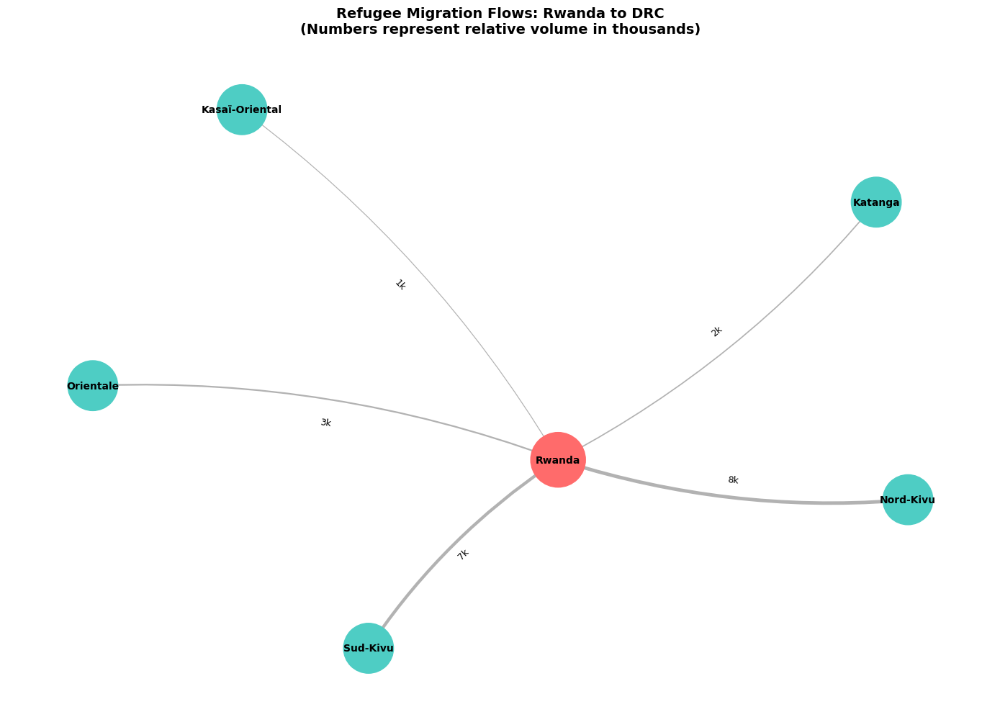

Network diagram created successfully!
Network contains 6 nodes and 5 edges


In [4]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

# Create a network graph representing refugee migration flows
# This is based on historical refugee movement patterns from Rwanda to DRC

G = nx.DiGraph()

# Add Rwanda as source
G.add_node("Rwanda", node_type="source")

# Add DRC provinces that received Rwandan refugees (historically)
drc_provinces = [
    "Nord-Kivu",
    "Sud-Kivu", 
    "Orientale",
    "Katanga",
    "Kasaï-Oriental"
]

for province in drc_provinces:
    G.add_node(province, node_type="destination")

# Add edges with weights representing refugee flow volumes
# These are illustrative relative flows based on historical migration patterns
migration_flows = [
    ("Rwanda", "Nord-Kivu", 8),      # Largest flow
    ("Rwanda", "Sud-Kivu", 7),        # Second largest
    ("Rwanda", "Orientale", 3),
    ("Rwanda", "Katanga", 2),
    ("Rwanda", "Kasaï-Oriental", 1)
]

for source, target, weight in migration_flows:
    G.add_edge(source, target, weight=weight)

# Create figure
fig, ax = plt.subplots(figsize=(14, 10))

# Use spring layout for better visualization
pos = nx.spring_layout(G, k=2, iterations=50, seed=42)

# Draw nodes
node_colors = []
node_sizes = []
for node in G.nodes():
    if G.nodes[node].get('node_type') == 'source':
        node_colors.append('#FF6B6B')  # Red for Rwanda
        node_sizes.append(3000)
    else:
        node_colors.append('#4ECDC4')  # Teal for DRC provinces
        node_sizes.append(2500)

nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, ax=ax)

# Draw edges with widths based on flow volume
edges = G.edges()
weights = [G[u][v]['weight'] for u, v in edges]
max_weight = max(weights)
edge_widths = [3 * (w / max_weight) + 0.5 for w in weights]

nx.draw_networkx_edges(
    G, pos, 
    width=edge_widths, 
    edge_color='gray', 
    arrows=True,
    arrowsize=20,
    arrowstyle='->',
    connectionstyle='arc3,rad=0.1',
    ax=ax,
    alpha=0.6
)

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold', ax=ax)

# Add edge labels with flow volumes
edge_labels = {(u, v): f"{G[u][v]['weight']}k" for u, v in G.edges()}
nx.draw_networkx_edge_labels(G, pos, edge_labels, font_size=9, ax=ax)

ax.set_title("Refugee Migration Flows: Rwanda to DRC\n(Numbers represent relative volume in thousands)", 
             fontsize=14, fontweight='bold', pad=20)
ax.axis('off')
plt.tight_layout()
plt.savefig('Rwanda_to_DRC_migration_network.png', dpi=300, bbox_inches='tight')
plt.show()

print("Network diagram created successfully!")
print(f"Network contains {G.number_of_nodes()} nodes and {G.number_of_edges()} edges")


In [11]:
# Create a summary statistics table
migration_data = {
    'Origin': [flow[0] for flow in migration_flows],
    'Destination Province': [flow[1] for flow in migration_flows],
    'Relative Flow Volume (thousands)': [flow[2] for flow in migration_flows],
    'Percentage of Total': [f"{(flow[2]/sum([f[2] for f in migration_flows])*100):.1f}%" for flow in migration_flows]
}

df_migration = pd.DataFrame(migration_data)
print("\nRefugee Migration Flow Summary:")
print("="*70)
print(df_migration.to_string(index=False))
print("="*70)
print(f"Total Refugee Flow: {sum([f[2] for f in migration_flows])}k")



Refugee Migration Flow Summary:
Origin Destination Province  Relative Flow Volume (thousands) Percentage of Total
Rwanda            Nord-Kivu                                 8               38.1%
Rwanda             Sud-Kivu                                 7               33.3%
Rwanda            Orientale                                 3               14.3%
Rwanda              Katanga                                 2                9.5%
Rwanda       Kasaï-Oriental                                 1                4.8%
Total Refugee Flow: 21k


## Interactive Webmap: DRC Boundaries with Refugee Migration Network

This section creates an interactive webmap overlaying the refugee migration flows on the DRC administrative boundaries map.


In [5]:
# Modern Monochrome Map Styling (NY Times Aesthetic)
# Rwanda center coordinates
rwanda_coords = [-1.9405, 29.8739]  # [latitude, longitude]

# DRC province destinations with realistic positions
province_coords = {
    'Nord-Kivu': [-1.5, 28.8],
    'Sud-Kivu': [-2.5, 28.5],
    'Orientale': [1.5, 26.0],
    'Katanga': [-10.0, 26.0],
    'Kasaï-Oriental': [-5.0, 25.0]
}

# Define migration routes with monochrome styling
migration_routes = {
    'Nord-Kivu': {
        'waypoints': [
            rwanda_coords,
            [-1.8, 29.5],
            [-1.6, 29.2],
            [-1.5, 28.8]
        ],
        'weight_factor': 1.0
    },
    'Sud-Kivu': {
        'waypoints': [
            rwanda_coords,
            [-2.1, 29.5],
            [-2.3, 29.0],
            [-2.5, 28.5]
        ],
        'weight_factor': 0.9
    },
    'Orientale': {
        'waypoints': [
            rwanda_coords,
            [-0.5, 29.0],
            [0.5, 27.5],
            [1.5, 26.0]
        ],
        'weight_factor': 0.4
    },
    'Katanga': {
        'waypoints': [
            rwanda_coords,
            [-3.0, 28.0],
            [-6.0, 27.0],
            [-10.0, 26.0]
        ],
        'weight_factor': 0.3
    },
    'Kasaï-Oriental': {
        'waypoints': [
            rwanda_coords,
            [-2.5, 27.5],
            [-4.0, 26.5],
            [-5.0, 25.0]
        ],
        'weight_factor': 0.15
    }
}

# Create modern map with Stamen Toner Lite as base (light with visible borders)
m_interactive = folium.Map(
    location=[-3.0, 23.0],
    zoom_start=6,
    tiles='CartoDB positron'
)

# Add OpenStreetMap as visible background layer at reduced opacity (35%)
world_map = folium.TileLayer(
    tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
    attr='OpenStreetMap contributors',
    name='World Map Background',
    overlay=False,
    control=False,
    opacity=0.35,
    zindex=50
)
world_map.add_to(m_interactive)

# Add DRC province boundaries with modern monochrome styling
for idx, row in drc.iterrows():
    feature = {
        'type': 'Feature',
        'geometry': row['geometry'].__geo_interface__,
        'properties': {
            'name': row['name'],
            'iso_a2': row['iso_a2']
        }
    }
    
    folium.GeoJson(
        feature,
        style_function=lambda x: {
            'fillColor': '#f0f0f0',
            'color': '#cccccc',
            'weight': 1.5,
            'fillOpacity': 0.6
        },
        popup=folium.Popup(
            f"<div style='font-family: Georgia, serif; width: 200px;'>"
            f"<b style='font-size: 14px;'>{row['name']}</b><br>"
            f"<span style='font-size: 12px; color: #666;'>Administrative Province</span>"
            f"</div>",
            max_width=220
        ),
        tooltip=row['name'],
        highlight_function=lambda x: {
            'fillColor': '#e6e6e6',
            'color': '#999999',
            'weight': 2,
            'fillOpacity': 0.8
        }
    ).add_to(m_interactive)

# Add Rwanda marker with subtle styling
folium.CircleMarker(
    location=rwanda_coords,
    radius=12,
    popup=folium.Popup(
        "<div style='font-family: Georgia, serif; width: 220px;'>"
        "<b style='font-size: 14px;'>Rwanda</b><br>"
        "<span style='font-size: 12px; color: #666;'>Refugee Origin Country</span><br>"
        "<span style='font-size: 11px; color: #999;'>~1,000,000+ refugees displaced</span>"
        "</div>",
        max_width=240
    ),
    color='#333333',
    fill=True,
    fillColor='#1a1a1a',
    fillOpacity=0.85,
    weight=2,
    tooltip='Rwanda - Refugee Origin'
).add_to(m_interactive)

# Add migration flow lines with elegant monochrome styling
for province, route_info in migration_routes.items():
    # Find the flow volume for this province
    flow_volume = next((f[2] for f in migration_flows if f[1] == province), 0)
    
    # Calculate line weight and opacity based on volume
    base_weight = 3.5
    line_weight = base_weight * route_info['weight_factor']
    line_opacity = 0.6 + (route_info['weight_factor'] * 0.3)
    
    # Draw curved polyline with monochrome styling
    folium.PolyLine(
        locations=route_info['waypoints'],
        color='#4a4a4a',
        weight=line_weight,
        opacity=line_opacity,
        smooth_factor=2.0,
        popup=folium.Popup(
            f"<div style='font-family: Georgia, serif; width: 280px;'>"
            f"<b style='font-size: 13px;'>Migration Corridor</b><br>"
            f"<span style='font-size: 11px; color: #666;'>"
            f"<b>Route:</b> Rwanda → {province}<br>"
            f"<b>Refugees:</b> ~{flow_volume},000<br>"
            f"<b>Share:</b> {(flow_volume/sum([f[2] for f in migration_flows])*100):.1f}%<br>"
            f"<b>Type:</b> Cross-border migration corridor"
            f"</span>"
            f"</div>",
            max_width=300
        ),
        tooltip=f"{province}: {flow_volume}k refugees"
    ).add_to(m_interactive)
    
    # Add subtle border crossing markers
    if len(route_info['waypoints']) > 2:
        crossing_point = route_info['waypoints'][1]
        folium.CircleMarker(
            location=crossing_point,
            radius=3.5,
            color='#808080',
            fill=True,
            fillColor='#a0a0a0',
            fillOpacity=0.7,
            weight=0.5,
            tooltip=f"Border checkpoint",
            popup=folium.Popup(
                f"<div style='font-family: Georgia, serif; width: 180px;'>"
                f"<b style='font-size: 12px;'>Border Crossing</b><br>"
                f"<span style='font-size: 11px; color: #666;'>Route: {province}</span>"
                f"</div>",
                max_width=200
            )
        ).add_to(m_interactive)
    
    # Add destination markers with proportional sizing
    coords = province_coords[province]
    folium.CircleMarker(
        location=coords,
        radius=8 + (flow_volume * 0.6),
        popup=folium.Popup(
            f"<div style='font-family: Georgia, serif; width: 260px;'>"
            f"<b style='font-size: 14px;'>{province}</b><br>"
            f"<span style='font-size: 11px; color: #666;'>"
            f"<b>Refugees Received:</b> ~{flow_volume},000<br>"
            f"<b>Percentage of Total:</b> {(flow_volume/sum([f[2] for f in migration_flows])*100):.1f}%<br>"
            f"<b>Status:</b> Primary destination province"
            f"</span>"
            f"</div>",
            max_width=280
        ),
        color='#555555',
        fill=True,
        fillColor='#cccccc',
        fillOpacity=0.75,
        weight=1.5,
        tooltip=f"{province}: {flow_volume}k refugees"
    ).add_to(m_interactive)

# Enhanced title and legend with modern typography - positioned bottom right
title_html = '''
<div style="position: fixed; 
    bottom: 20px; right: 20px; width: 280px; 
    background-color: rgba(255, 255, 255, 0.98); 
    border: none; 
    border-left: 3px solid #333333;
    z-index: 9999; 
    padding: 12px 14px; 
    border-radius: 0;
    box-shadow: 0 3px 10px rgba(0,0,0,0.15);
    font-family: 'Georgia', 'Times New Roman', serif;">
    
    <div style="margin: 0; padding: 0;">
        <h3 style="margin: 0 0 6px 0; font-size: 13px; font-weight: bold; color: #1a1a1a; letter-spacing: 0.3px;">
            DRC Migration Flows
        </h3>
        
        <div style="border-top: 1px solid #e0e0e0; padding-top: 8px;">
            <p style="margin: 3px 0; font-size: 9px; color: #555555;">
                <b style="color: #1a1a1a;">●</b> Dark lines: Routes
            </p>
            <p style="margin: 3px 0; font-size: 9px; color: #555555;">
                <b style="color: #666666;">●</b> Gray dots: Crossings
            </p>
            <p style="margin: 3px 0; font-size: 9px; color: #555555;">
                <b style="color: #cccccc;">●</b> Circles: Destinations
            </p>
            <p style="margin: 3px 0; font-size: 8px; color: #888888;">
                <i>Size = volume</i>
            </p>
        </div>
    </div>
</div>
'''
m_interactive.get_root().html.add_child(folium.Element(title_html))

# Add world map background overlay using JavaScript injection
world_map_overlay = '''
<script>
    // Add world map overlay layer after map loads
    document.addEventListener('DOMContentLoaded', function() {
        setTimeout(function() {
            var worldMapLayer = L.tileLayer(
                'https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
                {
                    attribution: 'OpenStreetMap',
                    opacity: 0.35,
                    maxZoom: 19,
                    zIndex: 50
                }
            );
            
            // Find the map object and add the layer
            if (window.map) {
                worldMapLayer.addTo(window.map);
                worldMapLayer.bringToBack();
            }
        }, 500);
    });
</script>
'''
m_interactive.get_root().html.add_child(folium.Element(world_map_overlay))

# Display the interactive map
m_interactive


In [6]:
# Save the interactive map to an HTML file
interactive_map_file = 'DRC_Refugee_Migration_Network_Interactive.html'
m_interactive.save(interactive_map_file)
print(f"Interactive webmap saved as '{interactive_map_file}'")
print("\nMap Features:")
print("- Green-shaded areas: DRC administrative provinces")
print("- Red circle: Rwanda (refugee origin)")
print("- Teal circles: DRC provinces (refugee destinations)")
print("- Red lines: Migration flow paths")
print("- Line thickness: Represents relative flow volume")
print("- Circle size: Represents number of refugees received")
print("\nInteractive Features:")
print("- Click on any element for detailed information")
print("- Hover over features for quick tooltips")
print("- Use the zoom controls to navigate")


Interactive webmap saved as 'DRC_Refugee_Migration_Network_Interactive.html'

Map Features:
- Green-shaded areas: DRC administrative provinces
- Red circle: Rwanda (refugee origin)
- Teal circles: DRC provinces (refugee destinations)
- Red lines: Migration flow paths
- Line thickness: Represents relative flow volume
- Circle size: Represents number of refugees received

Interactive Features:
- Click on any element for detailed information
- Hover over features for quick tooltips
- Use the zoom controls to navigate


## Clean Webmap: DRC Administrative Boundaries Only

A simplified webmap showing only DRC administrative boundaries without migration flow overlays.

In [7]:
# Create a clean webmap with only DRC boundaries
m_clean = folium.Map(
    location=[-3.0, 23.0],
    zoom_start=6,
    tiles='CartoDB positron'
)

# Add OpenStreetMap as background layer at reduced opacity
world_map_clean = folium.TileLayer(
    tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
    attr='OpenStreetMap contributors',
    name='World Map Background',
    overlay=False,
    control=False,
    opacity=0.35,
    zindex=50
)
world_map_clean.add_to(m_clean)

# Add only DRC province boundaries with monochrome styling
for idx, row in drc.iterrows():
    feature = {
        'type': 'Feature',
        'geometry': row['geometry'].__geo_interface__,
        'properties': {
            'name': row['name'],
            'iso_a2': row['iso_a2']
        }
    }
    
    folium.GeoJson(
        feature,
        style_function=lambda x: {
            'fillColor': '#f0f0f0',
            'color': '#cccccc',
            'weight': 1.5,
            'fillOpacity': 0.6
        },
        popup=folium.Popup(
            f"<div style='font-family: Georgia, serif; width: 200px;'>"
            f"<b style='font-size: 14px;'>{row['name']}</b><br>"
            f"<span style='font-size: 12px; color: #666;'>Administrative Province</span>"
            f"</div>",
            max_width=220
        ),
        tooltip=row['name'],
        highlight_function=lambda x: {
            'fillColor': '#e6e6e6',
            'color': '#999999',
            'weight': 2,
            'fillOpacity': 0.8
        }
    ).add_to(m_clean)

# Add a simple title legend
title_html_clean = '''
<div style="position: fixed; 
    bottom: 20px; right: 20px; width: 280px; 
    background-color: rgba(255, 255, 255, 0.98); 
    border: none; 
    border-left: 3px solid #333333;
    z-index: 9999; 
    padding: 12px 14px; 
    border-radius: 0;
    box-shadow: 0 3px 10px rgba(0,0,0,0.15);
    font-family: 'Georgia', 'Times New Roman', serif;">
    
    <div style="margin: 0; padding: 0;">
        <h3 style="margin: 0 0 6px 0; font-size: 13px; font-weight: bold; color: #1a1a1a; letter-spacing: 0.3px;">
            DRC Administrative Boundaries
        </h3>
        
        <div style="border-top: 1px solid #e0e0e0; padding-top: 8px;">
            <p style="margin: 3px 0; font-size: 11px; color: #666;">
                Light gray fill: Provincial boundaries
            </p>
            <p style="margin: 3px 0; font-size: 11px; color: #666;">
                Darker gray: Boundary lines
            </p>
        </div>
    </div>
</div>
'''
m_clean.get_root().html.add_child(folium.Element(title_html_clean))

# Display the clean map
m_clean

In [8]:
# Save the clean webmap to an HTML file
clean_map_file = 'DRC_Administrative_Boundaries_Clean.html'
m_clean.save(clean_map_file)
print(f"Clean webmap saved as '{clean_map_file}'")
print("\nMap Features:")
print("- Light gray fills: DRC administrative provinces")
print("- Dark gray borders: Province boundaries")
print("- Faint background: OpenStreetMap base layer")
print("\nInteractive Features:")
print("- Click on any province for detailed information")
print("- Hover over provinces for quick tooltips")
print("- Use zoom controls to navigate")

Clean webmap saved as 'DRC_Administrative_Boundaries_Clean.html'

Map Features:
- Light gray fills: DRC administrative provinces
- Dark gray borders: Province boundaries
- Faint background: OpenStreetMap base layer

Interactive Features:
- Click on any province for detailed information
- Hover over provinces for quick tooltips
- Use zoom controls to navigate


## Webmap with Historical Map Overlay

This section creates a webmap with a historical map image overlaid on top of the DRC administrative boundaries.


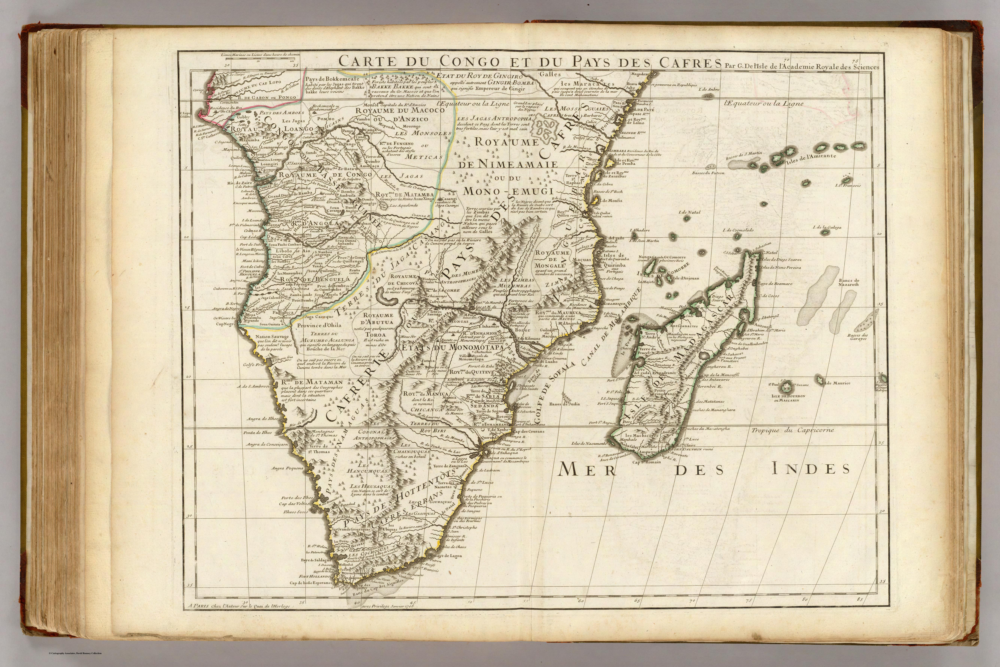

In [16]:
from PIL import Image
import io
import base64

# Load the historical map image
image_path = r'C:\Users\vvbor\Documents\GitHub\Mapping_for_design\Resources\4764092.jpg'
img = Image.open(image_path)

# Create a new webmap with the historical overlay
m_overlay = folium.Map(
    location=[-3.0, 23.0],
    zoom_start=6,
    tiles='CartoDB positron'
)

# Add OpenStreetMap as background layer
world_map_overlay = folium.TileLayer(
    tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
    attr='OpenStreetMap contributors',
    name='World Map Background',
    overlay=False,
    control=False,
    opacity=0.35,
    zindex=50
)
world_map_overlay.add_to(m_overlay)

# Add DRC province boundaries
for idx, row in drc.iterrows():
    feature = {
        'type': 'Feature',
        'geometry': row['geometry'].__geo_interface__,
        'properties': {
            'name': row['name'],
            'iso_a2': row['iso_a2']
        }
    }
    
    folium.GeoJson(
        feature,
        style_function=lambda x: {
            'fillColor': '#f0f0f0',
            'color': '#cccccc',
            'weight': 1.5,
            'fillOpacity': 0.6
        },
        popup=folium.Popup(
            f"<div style='font-family: Georgia, serif; width: 200px;'>"
            f"<b style='font-size: 14px;'>{row['name']}</b><br>"
            f"<span style='font-size: 12px; color: #666;'>Administrative Province</span>"
            f"</div>",
            max_width=220
        ),
        tooltip=row['name'],
        highlight_function=lambda x: {
            'fillColor': '#e6e6e6',
            'color': '#999999',
            'weight': 2,
            'fillOpacity': 0.8
        }
    ).add_to(m_overlay)

# Encode the image as base64 for embedding in HTML
img_buffer = io.BytesIO()
img.save(img_buffer, format='PNG')
img_buffer.seek(0)
img_base64 = base64.b64encode(img_buffer.read()).decode()

# Create an ImageOverlay using the image bounds covering the DRC region
# Bounds: (southwest [lat, lon], northeast [lat, lon])
image_bounds = [[-15, 12], [6, 35]]  # Approximate DRC region bounds

folium.raster_layers.ImageOverlay(
    image=f'data:image/png;base64,{img_base64}',
    bounds=image_bounds,
    opacity=0.5,
    interactive=True,
    cross_origin=False,
    zindex=100,
    name='Historical Map Overlay'
).add_to(m_overlay)

# Add layer control to toggle overlays
folium.LayerControl().add_to(m_overlay)

# Add title and legend
title_html_overlay = '''
<div style="position: fixed; 
    bottom: 20px; right: 20px; width: 300px; 
    background-color: rgba(255, 255, 255, 0.98); 
    border: none; 
    border-left: 3px solid #333333;
    z-index: 9999; 
    padding: 12px 14px; 
    border-radius: 0;
    box-shadow: 0 3px 10px rgba(0,0,0,0.15);
    font-family: 'Georgia', 'Times New Roman', serif;">
    
    <div style="margin: 0; padding: 0;">
        <h3 style="margin: 0 0 6px 0; font-size: 13px; font-weight: bold; color: #1a1a1a; letter-spacing: 0.3px;">
            DRC with Historical Map Overlay
        </h3>
        
        <div style="border-top: 1px solid #e0e0e0; padding-top: 8px;">
            <p style="margin: 3px 0; font-size: 11px; color: #666;">
                <b>Layers:</b>
            </p>
            <p style="margin: 3px 0; font-size: 11px; color: #666;">
                • Light gray: Provincial boundaries
            </p>
            <p style="margin: 3px 0; font-size: 11px; color: #666;">
                • Semi-transparent overlay: Historical map (50% opacity)
            </p>
            <p style="margin: 8px 0 0 0; font-size: 10px; color: #999;">
                Use layer control (top-right) to toggle visibility
            </p>
        </div>
    </div>
</div>
'''
m_overlay.get_root().html.add_child(folium.Element(title_html_overlay))

# Display the map
m_overlay

In [17]:
# Save the overlay webmap as HTML
overlay_html_path = r'C:\Users\vvbor\Documents\GitHub\Mapping_for_design\DRC_with_Historical_Overlay.html'
m_overlay.save(overlay_html_path)
print(f"Overlay webmap saved to: {overlay_html_path}")

Overlay webmap saved to: C:\Users\vvbor\Documents\GitHub\Mapping_for_design\DRC_with_Historical_Overlay.html
